In [1]:
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '2'
import torch
torch.rand(10)
import torch.nn as nn
import torch.nn.functional as F

print(torch.cuda.is_available())
print(torch.cuda.get_device_name())
print(torch.cuda.current_device())

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print('Using device:', device)
print()

#Additional Info when using cuda
if device.type == 'cuda':
    print(torch.cuda.get_device_name(0))
    print('Memory Usage:')
    print('Allocated:', round(torch.cuda.memory_allocated(0)/1024**3,1), 'GB')
    print('Cached:   ', round(torch.cuda.memory_reserved(0)/1024**3,1), 'GB')


True
TITAN RTX
0
Using device: cuda

TITAN RTX
Memory Usage:
Allocated: 0.0 GB
Cached:    0.0 GB


In [2]:
# define number of classes based on YAML
import yaml
with open("/home/user01/data_ssd/Talha/yolo/paprika_y5/data.yaml", 'r') as stream:
    num_classes = str(yaml.safe_load(stream)['nc'])
print(num_classes)

6


In [3]:
%cat "/home/user01/data_ssd/Talha/yolo/paprika_y5/data.yaml"

train: /home/user01/data_ssd/Talha/yolo/paprika_y5/train/images
val: /home/user01/data_ssd/Talha/yolo/paprika_y5/test/images

nc: 6
names: ["blossom_end_rot", "graymold","powdery_mildew","spider_mite","spotting_disease", "snails_and_slugs"]

In [4]:
#this is the model configuration we will use for our tutorial 
%cat /home/user01/data_ssd/Talha/yolo/yolov5/models/yolov5s.yaml

# parameters
nc: 80  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, C3, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, C

In [5]:
#customize iPython writefile so we can write variables
from IPython.core.magic import register_line_cell_magic

@register_line_cell_magic
def writetemplate(line, cell):
    with open(line, 'w') as f:
        f.write(cell.format(**globals()))


In [6]:
%%writetemplate /home/user01/data_ssd/Talha/yolo/yolov5/models/custom_yolov5s.yaml

# parameters
nc: {num_classes}  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, BottleneckCSP, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, BottleneckCSP, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, BottleneckCSP, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, BottleneckCSP, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, BottleneckCSP, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, BottleneckCSP, [256, False]],  # 17 (P3/8-small)

   [-1, 1, Conv, [256, 3, 2]],
   [[-1, 14], 1, Concat, [1]],  # cat head P4
   [-1, 3, BottleneckCSP, [512, False]],  # 20 (P4/16-medium)

   [-1, 1, Conv, [512, 3, 2]],
   [[-1, 10], 1, Concat, [1]],  # cat head P5
   [-1, 3, BottleneckCSP, [1024, False]],  # 23 (P5/32-large)

   [[17, 20, 23], 1, Detect, [nc, anchors]],  # Detect(P3, P4, P5)
  ]

# Train Custom YOLOv5 Detector

### Next, we'll fire off training!


Here, we are able to pass a number of arguments:
- **img:** define input image size
- **batch:** determine batch size
- **epochs:** define the number of training epochs. (Note: often, 3000+ are common here!)
- **data:** set the path to our yaml file
- **cfg:** specify our model configuration
- **weights:** specify a custom path to weights. (Note: you can download weights from the Ultralytics Google Drive [folder](https://drive.google.com/open?id=1Drs_Aiu7xx6S-ix95f9kNsA6ueKRpN2J))
- **name:** result names
- **nosave:** only save the final checkpoint
- **cache:** cache images for faster training

In [7]:
%%time
# train yolov5s on custom data for 100 epochs
# time its performance
%cd /home/user01/data_ssd/Talha/yolo/yolov5/
!python train.py --img 416 --batch 16 --epochs 100 \
        --data '/home/user01/data_ssd/Talha/yolo/paprika_y5/data.yaml' \
        --cfg ./models/custom_yolov5s.yaml \
        --weights '' \
        --name yolov5s_results  \
        --cache

/home/user01/data_ssd/Talha/yolo/yolov5
github: skipping check (offline)
YOLOv5 🚀 v5.0-48-g955eea8 torch 1.8.1+cu102 CUDA:0 (TITAN RTX, 24217.8125MB)

Namespace(adam=False, artifact_alias='latest', batch_size=16, bbox_interval=-1, bucket='', cache_images=True, cfg='./models/custom_yolov5s.yaml', data='/home/user01/data_ssd/Talha/yolo/paprika_y5/data.yaml', device='', entity=None, epochs=100, evolve=False, exist_ok=False, global_rank=-1, hyp='data/hyp.scratch.yaml', image_weights=False, img_size=[416, 416], label_smoothing=0.0, linear_lr=False, local_rank=-1, multi_scale=False, name='yolov5s_results', noautoanchor=False, nosave=False, notest=False, project='runs/train', quad=False, rect=False, resume=False, save_dir='runs/train/yolov5s_results2', save_period=-1, single_cls=False, sync_bn=False, total_batch_size=16, upload_dataset=False, weights='', workers=8, world_size=1)
tensorboard: Start with 'tensorboard --logdir runs/train', view at http://localhost:6006/
hyperparameters: lr0=0.01

# Evaluate Custom YOLOv5 Detector Performance

Training losses and performance metrics are saved to Tensorboard and also to a logfile defined above with the **--name** flag when we train. In our case, we named this `yolov5s_results`. (If given no name, it defaults to `results.txt`.) The results file is plotted as a png after training completes.

Note from Glenn: Partially completed `results.txt` files can be plotted with `from utils.utils import plot_results; plot_results()`.

In [ ]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

GROUND TRUTH TRAINING DATA:


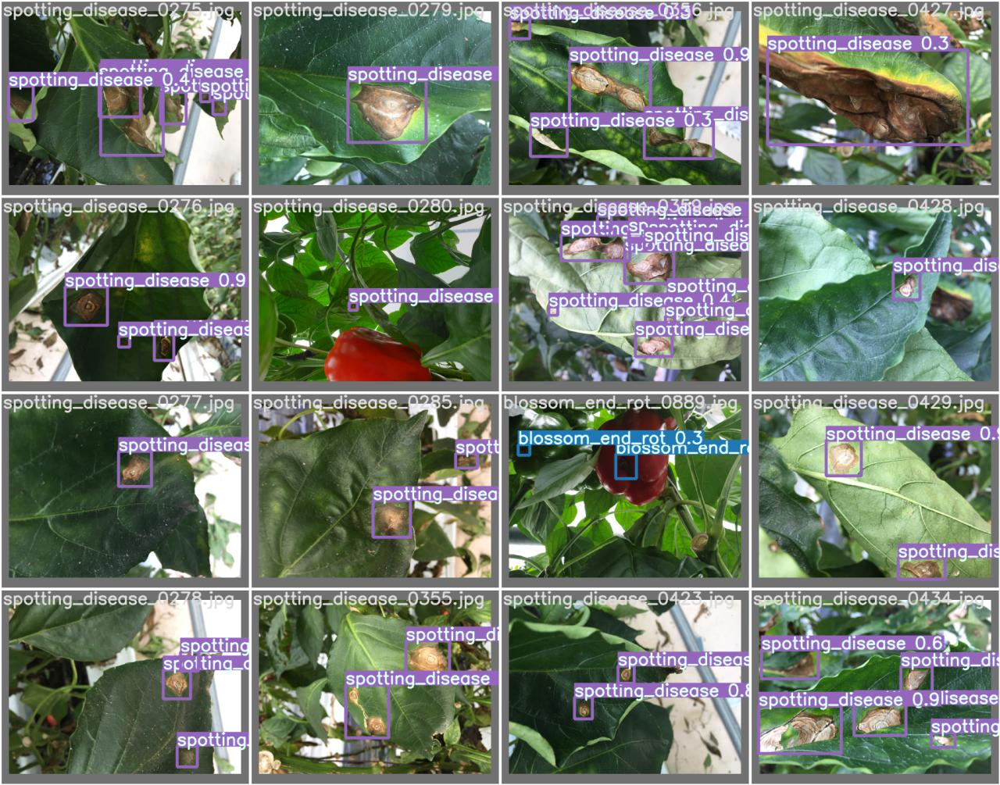

In [16]:
# first, display our ground truth data
print("GROUND TRUTH TRAINING DATA:")
Image(filename='/home/user01/data_ssd/Talha/yolo/yolov5/runs/train/yolov5s_results/test_batch1_pred.jpg', width=900)

GROUND TRUTH AUGMENTED TRAINING DATA:


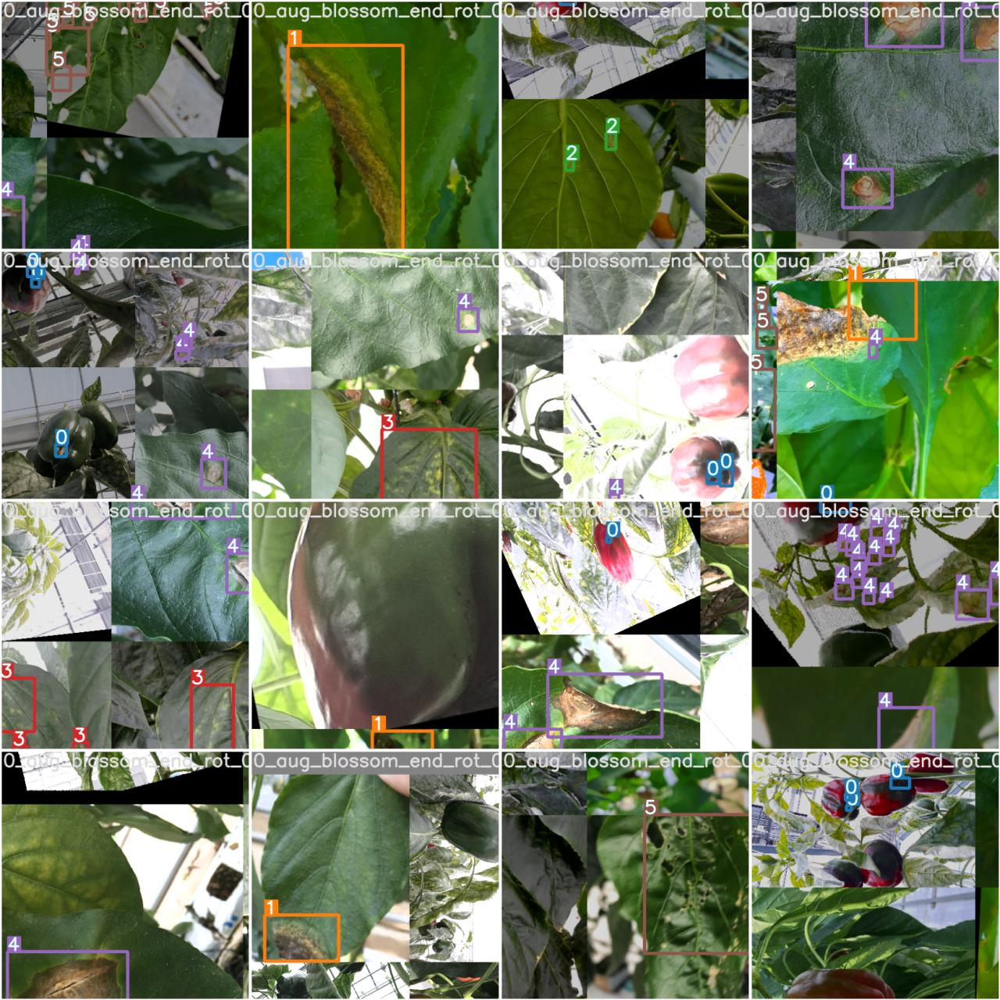

In [17]:
# print out an augmented training example
print("GROUND TRUTH AUGMENTED TRAINING DATA:")
Image(filename='/home/user01/data_ssd/Talha/yolo/yolov5/runs/train/yolov5s_results/train_batch2.jpg', width=900)

#Run Inference  With Trained Weights
Run inference with a pretrained checkpoint on contents of `test/images` folder downloaded from Roboflow.

In [18]:
# trained weights are saved by default in our weights folder
%ls runs/

train/


In [20]:
%ls /home/user01/data_ssd/Talha/yolo/yolov5/runs/train/yolov5s_results/weights/

best.pt  last.pt


In [21]:
# when we ran this, we saw .007 second inference time. That is 140 FPS on a TESLA P100!
# use the best weights!
%cd /home/user01/data_ssd/Talha/yolo/yolov5/
!python detect.py \
        --weights /home/user01/data_ssd/Talha/yolo/yolov5/runs/train/yolov5s_results/weights/best.pt \
        --img 416 --conf 0.4 \
        --source /home/user01/data_ssd/Talha/yolo/paprika_y5/valid/images/

# this will wrtie the image files in 
# /home/user01/data_ssd/Talha/yolo/yolov5/runs/detect/exp/

/home/user01/data_ssd/Talha/yolo/yolov5
Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.4, device='', exist_ok=False, hide_conf=False, hide_labels=False, img_size=416, iou_thres=0.45, line_thickness=3, name='exp', nosave=False, project='runs/detect', save_conf=False, save_crop=False, save_txt=False, source='/home/user01/data_ssd/Talha/yolo/paprika_y5/test/images/', update=False, view_img=False, weights=['/home/user01/data_ssd/Talha/yolo/yolov5/runs/train/yolov5s_results/weights/best.pt'])
YOLOv5 🚀 v5.0-48-g955eea8 torch 1.8.1+cu102 CUDA:0 (TITAN RTX, 24217.8125MB)

Fusing layers... 
Model Summary: 232 layers, 7260003 parameters, 0 gradients, 16.8 GFLOPS
image 1/2030 /home/user01/data_ssd/Talha/yolo/paprika_y5/test/images/blossom_end_rot_0014.jpg: 416x416 1 blossom_end_rot, Done. (0.007s)
image 2/2030 /home/user01/data_ssd/Talha/yolo/paprika_y5/test/images/blossom_end_rot_0052.jpg: 416x416 1 blossom_end_rot, 1 spotting_disease, Done. (0.007s)
image 3/2030 /home/u

image 54/2030 /home/user01/data_ssd/Talha/yolo/paprika_y5/test/images/blossom_end_rot_0368.jpg: 416x416 2 blossom_end_rots, 10 spotting_diseases, Done. (0.007s)
image 55/2030 /home/user01/data_ssd/Talha/yolo/paprika_y5/test/images/blossom_end_rot_0370.jpg: 416x416 1 blossom_end_rot, 7 spotting_diseases, Done. (0.008s)
image 56/2030 /home/user01/data_ssd/Talha/yolo/paprika_y5/test/images/blossom_end_rot_0371.jpg: 320x416 1 blossom_end_rot, Done. (0.008s)
image 57/2030 /home/user01/data_ssd/Talha/yolo/paprika_y5/test/images/blossom_end_rot_0372.jpg: 416x416 1 blossom_end_rot, Done. (0.008s)
image 58/2030 /home/user01/data_ssd/Talha/yolo/paprika_y5/test/images/blossom_end_rot_0376.jpg: 416x416 2 blossom_end_rots, 1 spotting_disease, Done. (0.006s)
image 59/2030 /home/user01/data_ssd/Talha/yolo/paprika_y5/test/images/blossom_end_rot_0378.jpg: 416x416 1 blossom_end_rot, 1 spotting_disease, Done. (0.007s)
image 60/2030 /home/user01/data_ssd/Talha/yolo/paprika_y5/test/images/blossom_end_rot_0

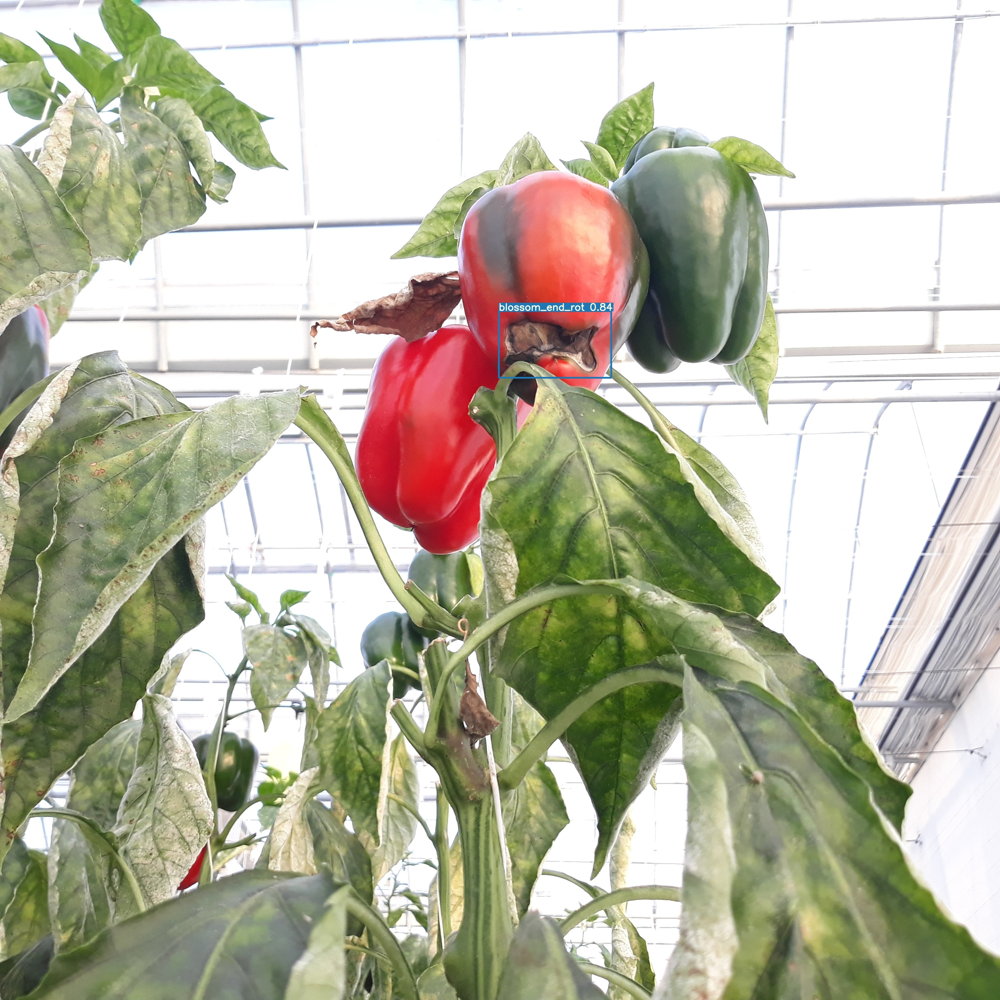

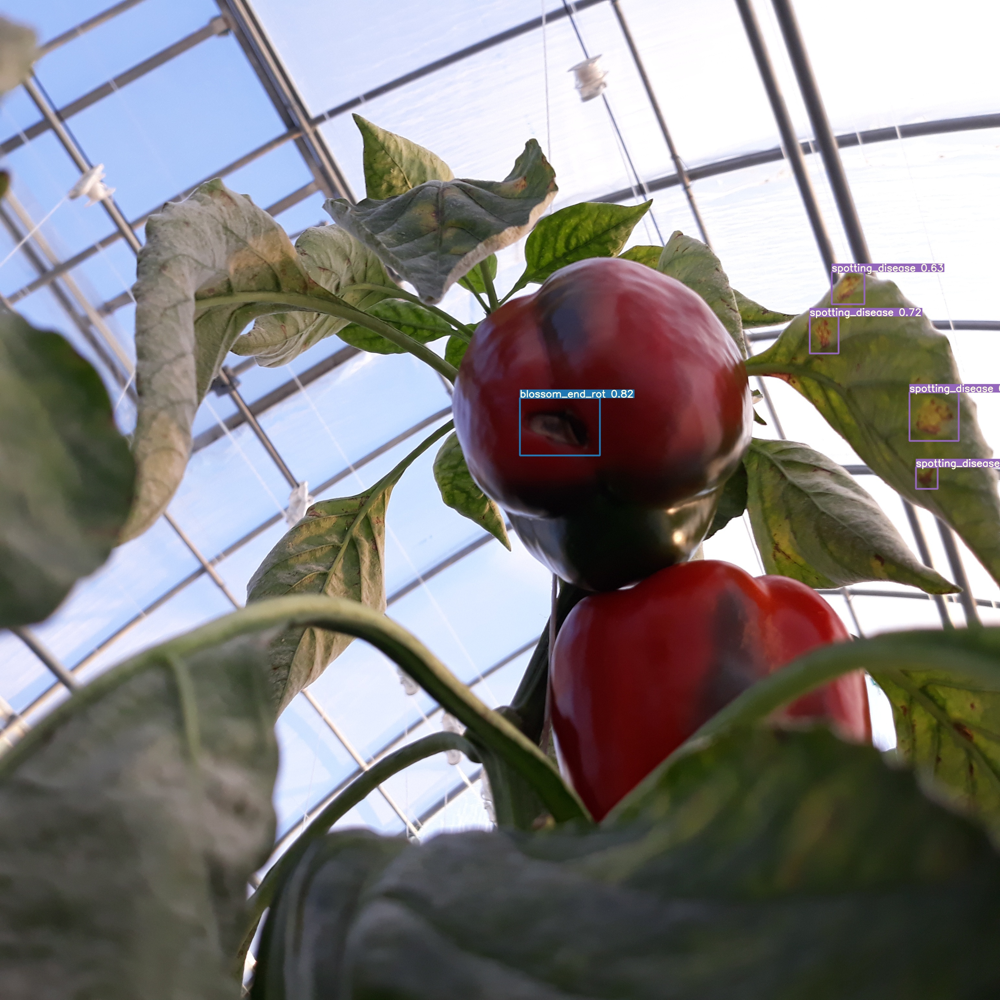

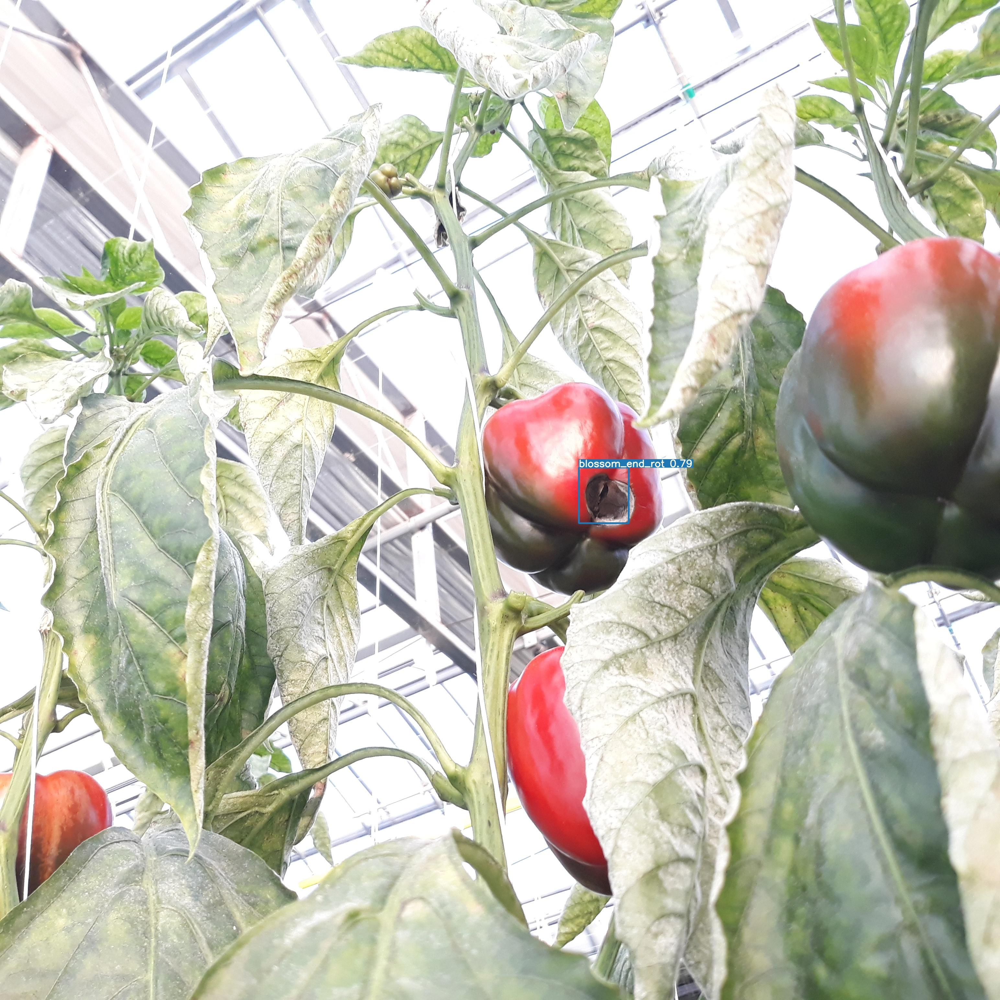

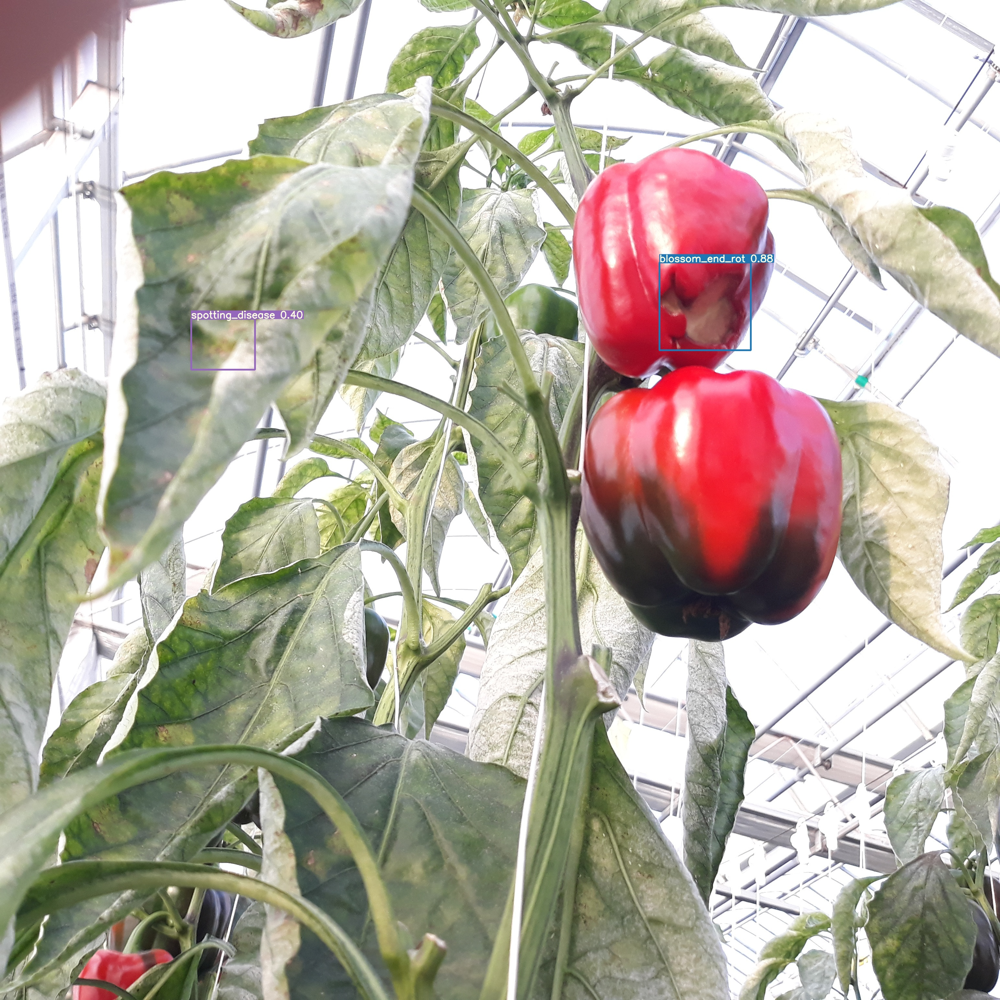

In [22]:
#display inference on ALL test images
#this looks much better with longer training above

import glob
from IPython.display import Image, display

for imageName in glob.glob('/home/user01/data_ssd/Talha/yolo/yolov5/runs/detect/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")